In [1]:
## HW 1 Part 2 - Python Script 
## Author - Nirja Mistry
## ISOM 672 - Intro to Business Analytics

# Ensuring the code is compatible across all versions of Python for multiple devices
from __future__ import division, print_function, unicode_literals

# Importing essential packages for computing in Python and setting it up to run effeciently 
import numpy as np
import scipy as sp
import os

np.random.seed(42)

# These packages will allow for better and creative plots
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt

# Setting the font size for the plots
plt.rcParams['axes.labelsize'] = 14 
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Assigning the parameters 
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "decision_trees"

# Defining a new function that returns the image path
def image_path(fig_id):
    return os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID, fig_id)
# Define another function to save the plot returned locally 
def save_fig(fig_id, tight_layout=True):
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
        plt.savefig(image_path(fig_id) + ".png", format='png', dpi=300)

In [2]:
# Importing pandas package to read in our dataset
import pandas as pd
# Importing our dataset about consumer contracts and naming it as churn
churn = pd.read_csv('C:\\Users\\nirja\\OneDrive\\Desktop\\MSBA\\Intro to Business Analytics\\HW1_Data.csv')

# Importing this to create our Decision Tree
from sklearn.tree import DecisionTreeClassifier

# Importing packages for running descriptive and statistical analyses
import seaborn as sns
sns.set(color_codes=True)
from scipy import stats

# Exploring the different variables for their summary statistics
print(churn.describe())

            revenue      outcalls       incalls        months       eqpdays  \
count  31891.000000  31891.000000  31891.000000  31891.000000  31891.000000   
mean      58.665179     24.951385      8.065277     18.761908    391.222633   
std       44.163859     34.790147     16.610589      9.548019    254.998478   
min       -5.860000      0.000000      0.000000      6.000000     -5.000000   
25%       33.450000      3.000000      0.000000     11.000000    212.000000   
50%       48.380000     13.330000      2.000000     17.000000    341.000000   
75%       71.040000     33.330000      9.000000     24.000000    530.000000   
max      861.110000    610.330000    404.000000     60.000000   1812.000000   

             webcap      marryyes        travel         pcown      creditcd  \
count  31891.000000  31891.000000  31891.000000  31891.000000  31891.000000   
mean       0.894704      0.363175      0.057163      0.184817      0.676931   
std        0.306939      0.480922      0.232158    

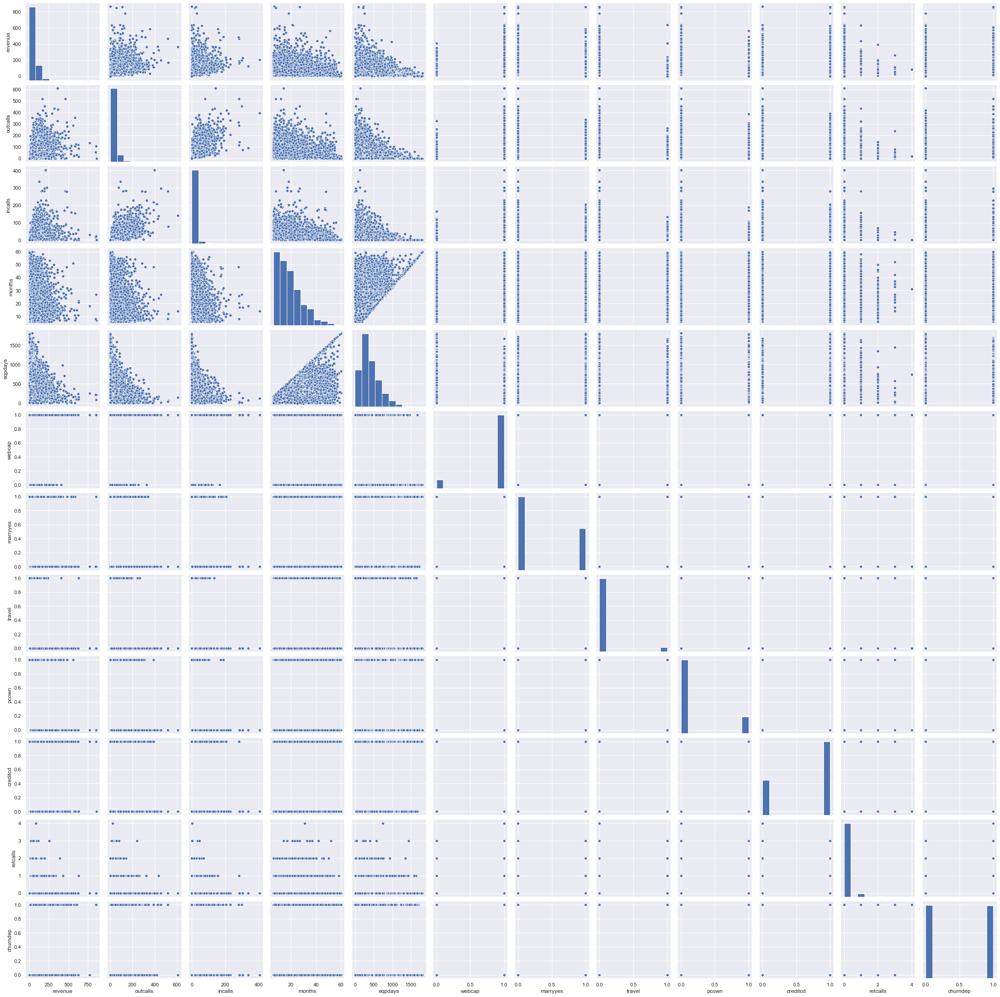

In [3]:
# Plotting the variables to explore the relationship and interactions between them 
sns.pairplot(churn)

In [4]:
# Assigning the dependent/feature variables to X and the target variable to y
feature_cols = ["revenue", "outcalls", "incalls", "months", "eqpdays", "webcap", "marryyes", "travel", "pcown", "creditcd", 
                "retcalls"]
X = churn[feature_cols]
y = churn.churndep
# Fitting the Decision Tree model on our dataset 
plt.clf()
tree_clf = DecisionTreeClassifier(criterion='entropy', splitter='best', random_state=42, max_depth=None)
tree_clf.fit(X, y)

DecisionTreeClassifier(criterion='entropy', random_state=42)

<Figure size 432x288 with 0 Axes>

In [5]:
import graphviz
from sklearn import tree

# Creating Decision Tree without any maximum depth specified
dot_data = tree.export_graphviz(tree_clf, out_file=None,
                                feature_names=feature_cols,
                                class_names=['Churn', 'No Churn'],
                                filled=True, rounded=True,
                                special_characters=True)

graph = graphviz.Source(dot_data) 
graph

Confusion matrix, without normalization
[[2179 1805]
 [1856 2133]]
Normalized confusion matrix
[[0.55 0.45]
 [0.47 0.53]]


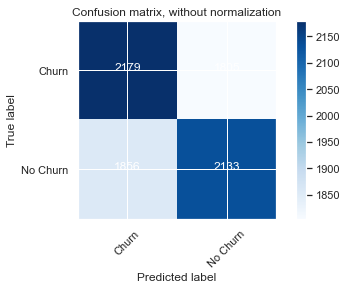

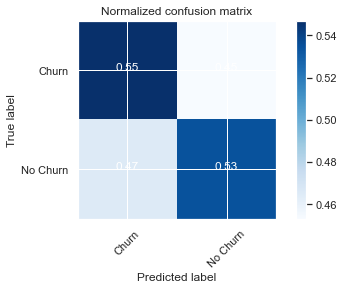

In [6]:
from sklearn.metrics import confusion_matrix
import itertools
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Split the data into training and test set. No criteria mentioned for split so default will be 25% for test set.
# Train_test_split will also shuffle the data before splitting it 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=100, shuffle=True)

# Build the decision tree and make predictions on the test data
y_pred = tree_clf.fit(X_train, y_train).predict(X_test)

# Define a new function to compute confusion matrix
def plot_confusion_matrix(feature_cols, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        feature_cols = feature_cols.astype('float') / feature_cols.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(feature_cols)

    plt.imshow(feature_cols, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = feature_cols.max() / 2.
    for i, j in itertools.product(range(feature_cols.shape[0]), range(feature_cols.shape[1])):
        plt.text(j, i, format(feature_cols[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if feature_cols[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

# Creating the confusion matrix to show accuracy of the model
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Churn', 'No Churn'],
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Churn', 'No Churn'], normalize=True,
                      title='Normalized confusion matrix')

plt.show()

In [7]:
# Evaluating the goodness of the model through various metrics like Accuracy, Precision, Recall, and F-Measure
# Source - https://stackoverflow.com/questions/31421413/how-to-compute-precision-recall-accuracy-and-f1-score-for-the-multiclass-case
# Source - https://machinelearningmastery.com/precision-recall-and-f-measure-for-imbalanced-classification/

from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score

print('Accuracy:', accuracy_score(y_test, y_pred))
print('Precision:', precision_score(y_test, y_pred, average='binary'))
print('Recall:', recall_score(y_test, y_pred, average='binary'))
print('F-Measure:', f1_score(y_test, y_pred, average='binary'))

Accuracy: 0.5408252853380158
Precision: 0.5416455053326562
Recall: 0.53472048132364
F-Measure: 0.538160716538413


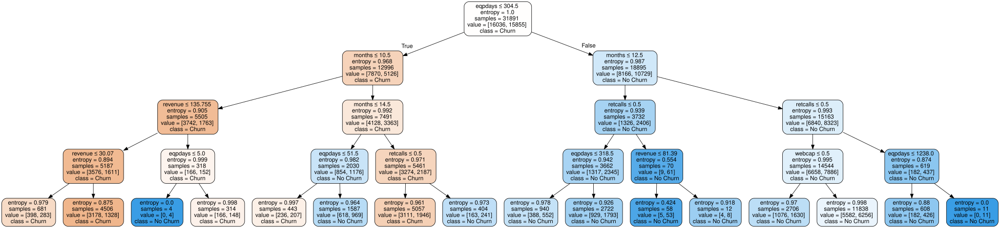

<Figure size 432x288 with 0 Axes>

In [89]:
# Building a better and more accurate model by picking appropriate parameters 
plt.clf()
tree_clf_best = DecisionTreeClassifier(criterion='entropy', splitter='best', random_state=42, max_depth=4, min_samples_split=5,
                                       min_samples_leaf=3)
tree_clf_best.fit(X, y)

# Creating Decision Tree with best parameters 
dot_data_best = tree.export_graphviz(tree_clf_best, out_file=None,
                                feature_names=feature_cols,
                                class_names=['Churn', 'No Churn'],
                                filled=True, rounded=True,
                                special_characters=True)

graph = graphviz.Source(dot_data_best) 
graph

Confusion matrix, without normalization
[[1720 2302]
 [ 896 3055]]
Normalized confusion matrix
[[0.43 0.57]
 [0.23 0.77]]


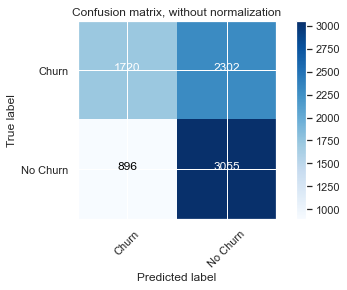

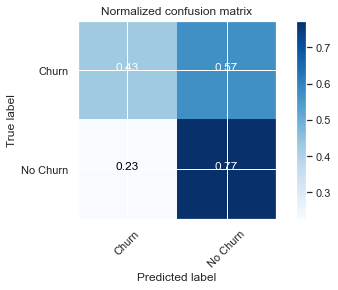

In [90]:
# Split the data into training and test set. No criteria mentioned for split so default will be 25% for test set.
# Train_test_split will also shuffle the data before splitting it 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=10, shuffle=True)

# Build the decision tree and make predictions on the test data
y_pred = tree_clf_best.fit(X_train, y_train).predict(X_test)

# Creating the confusion matrix to show accuracy of the model
cnf_matrix = confusion_matrix(y_test, y_pred)
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Churn', 'No Churn'],
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Churn', 'No Churn'], normalize=True,
                      title='Normalized confusion matrix')

plt.show()

In [91]:
# Evaluating the goodness of the model through various metrics like Accuracy, Precision, Recall, and F-Measure
# Source - https://stackoverflow.com/questions/31421413/how-to-compute-precision-recall-accuracy-and-f1-score-for-the-multiclass-case
# Source - https://machinelearningmastery.com/precision-recall-and-f-measure-for-imbalanced-classification/

from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score

print('Accuracy:', accuracy_score(y_test, y_pred))
print('Precision:', precision_score(y_test, y_pred, average='binary'))
print('Recall:', recall_score(y_test, y_pred, average='binary'))
print('F-Measure:', f1_score(y_test, y_pred, average='binary'))

Accuracy: 0.5988962749278816
Precision: 0.5702818741833116
Recall: 0.7732219691217413
F-Measure: 0.6564245810055865
